# Dependencies

In [1]:
import warnings
warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
%matplotlib inline

import sys
import os

import numpy as np
import cv2

from keras.models import Model
from keras.layers import Input, Lambda
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers import concatenate
from keras.optimizers import Adam
from keras import backend as K

from skimage.measure import compare_psnr

Using TensorFlow backend.


In [24]:
import numpy as np

import tensorflow
import keras

from keras.models import Sequential, Model
from keras.engine.input_layer import Input
from keras.layers import Dense, Conv2D, BatchNormalization, LeakyReLU, Lambda, Concatenate

# credit to: https://github.com/sabakanation/DeepImagePrior
def reflection_padding(x, padding):
    reflected = Lambda(lambda x: x[:, :, ::-1, :])(x)
    reflected = Lambda(lambda x: x[:, :, :padding[1], :])(reflected)
    upper_row = concatenate([x, reflected], axis=2)
    lower_row = Lambda(lambda x: x[:, ::-1, :, :])(upper_row)
    lower_row = Lambda(lambda x: x[:, :padding[0], :, :])(lower_row)
    padded = concatenate([upper_row, lower_row], axis=1)
    return padded

def get_layer_size(x):
    height, width = x.get_shape()[1:3]
    height = int(height)
    width = int(width)
    return [height, width]

def Conv_BN_Act(layer, num_channels=128, kernel_size=3, strides=(1,1)):
    size = get_layer_size(layer)

    padding = [0, 0]
    padding[0] = (int(size[0]/strides[0]) - 1) * strides[0] + kernel_size - size[0]
    padding[1] = (int(size[1]/strides[1]) - 1) * strides[1] + kernel_size - size[1]
    layer = reflection_padding(layer, padding)

    layer = Conv2D(num_channels, kernel_size, strides=strides, padding='valid', activation=None)(layer)
    layer = BatchNormalization()(layer)
    layer = LeakyReLU(alpha=0.2)(layer)

    return layer

# mostly based on: https://github.com/beala/deep-image-prior-tensorflow
def down_layer(layer, num_channels=128, kernel_size=3):
    size = get_layer_size(layer)
    if size[0] % 2 != 0:
        layer = reflection_padding(layer, [1, 0])
    if size[1] % 2 != 0:
        layer = reflection_padding(layer, [0, 1])

    layer = Conv_BN_Act(layer, num_channels, kernel_size, (2, 2))
    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    
    return layer

def up_layer(layer, num_channels=128, kernel_size=3, inter="bilinear"):
    layer = UpSampling2D(size=(2, 2))(layer)

    if inter == "bilinear":
        layer_padded = reflection_padding(layer, (1, 1))
        layer = Lambda(lambda x: (x[:, :-1, 1:, :] + x[:, 1:, :-1, :] + x[:, :-1, :-1, :] + x[:, :-1, :-1, :]) / 4.0)(layer_padded)

    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    layer = Conv_BN_Act(layer, num_channels, 1, (1, 1))
    
    return layer

def skip(layer, num_channels=4, kernel_size=1):
    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    return layer

def build_model(input_shape, num_depth, down_channels, up_channels, down_kernel, up_kernel, skip_channel, skip_kernel, inter):
    input_layer = Input(shape=input_shape)

    # Connect up all the downsampling layers.
    skips = []
    layer = input_layer
    size = get_layer_size(layer)
    sizes = [size]
    for i in range(num_depth):
        layer = down_layer(layer, down_channels[i], down_kernel[i])
        size = get_layer_size(layer)
        sizes.append(size)
        if skip_channel[i] != 0:
            skips.append(skip(layer, skip_channel[i], skip_kernel[i]))
        else:
            skips.append(None)
    print("Shape after downsample: " + str(layer.get_shape()))

    # Connect up the upsampling layers, from smallest to largest.
    for i in range(num_depth-1, -1, -1):
        if skip_channel[i] != 0:
            layer = concatenate([layer, skips[i]], axis=3)
        layer = up_layer(layer, up_channels[i], up_kernel[i], inter)
        size = get_layer_size(layer)

        if sizes[i] != size:
            layer = Lambda(lambda x: x[:, :sizes[i][0], :sizes[i][1], :])(layer)

    print("Shape after upsample: " + str(layer.get_shape()))

    # Restore original image dimensions and channels
    output_layer = Conv2D(3, 1, strides=1, padding='valid', activation=None)(layer)
    print("Output shape: " + str(output_layer.get_shape()))
    
    model = Model(inputs=input_layer, outputs=output_layer)

    return model

In [38]:
from keras.losses import mean_squared_error

def mse_mask(y_true, y_pred):
    return mean_squared_error(y_true * img_mask, y_pred * img_mask)

def define_denoising_model(height, width):
    input_shape = (height, width, 32)
    num_depth = 5
    up_channels = [128, 128, 128, 128, 128]
    down_channels = [128, 128, 128, 128, 128]
    up_kernel = [3, 3, 3, 3, 3]
    down_kernel = [3, 3, 3, 3, 3]
    skip_channel = [0, 0, 0, 0, 0]
    skip_kernel = [0, 0, 0, 0, 0]
    lr = 0.01
    inter = "bilinear"
    
#     model = define_model(num_u, num_d, kernel_u, kernel_d, num_s, kernel_s, height, width, inter, lr)
    model = build_model(input_shape, num_depth, down_channels, up_channels, down_kernel, up_kernel, skip_channel, skip_kernel, inter)
    model.compile(loss=mse_mask, optimizer=Adam(lr=lr))

    return model


# def denoising(image):
#     height, width = image.shape[:2]
#     model = define_denoising_model(height, width)
#     input_noise = np.random.uniform(0, 0.1, (1, height, width, 32))

#     for i in range(1800):
#         model.train_on_batch(input_noise + np.random.normal(0, 1/30.0, (height, width, 32)), image[None, :, :, :])

#     return np.clip(model.predict(input_noise)[0], 0, 255).astype(np.uint8)




# Read Image

In [5]:
fname = 'data/restoration/kate.png'
image = cv2.imread(fname)

In [22]:
height, width = image.shape[:2]

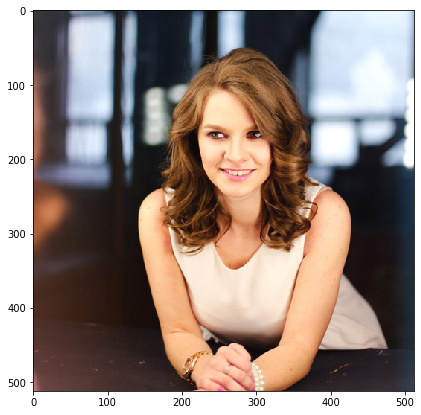

In [9]:
plt.figure(figsize=(7, 7))
plt.imshow(image[:,:,::-1])
plt.show()

In [28]:
zero_fraction = 0.2
img_mask=(np.random.random_sample(size=image.shape) > zero_fraction).astype(np.uint8)
img_mask[1] = img_mask[0]
img_mask[2] = img_mask[0]

In [29]:
img_masked = image * img_mask

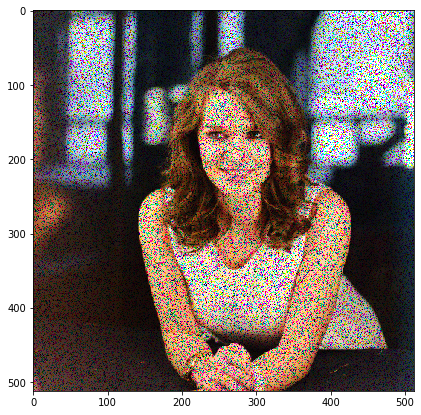

In [30]:
plt.figure(figsize=(7, 7))
plt.imshow(img_masked[:,:,::-1])
plt.show()

In [26]:
model = define_denoising_model(height, width)
input_noise = np.random.uniform(0, 0.1, (1, height, width, 32))

W0805 16:23:54.684363 4474004928 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0805 16:23:54.711488 4474004928 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0805 16:23:54.771290 4474004928 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0805 16:23:54.811444 4474004928 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Pl

Shape after downsample: (?, 16, 16, 128)


W0805 16:23:59.031144 4474004928 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



Shape after upsample: (?, 512, 512, 128)
Output shape: (?, 512, 512, 3)


In [27]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 32) 0                                            
__________________________________________________________________________________________________
lambda_1 (Lambda)               (None, 512, 512, 32) 0           input_1[0][0]                    
__________________________________________________________________________________________________
lambda_2 (Lambda)               (None, 512, 1, 32)   0           lambda_1[0][0]                   
__________________________________________________________________________________________________
concatenate_1 (Concatenate)     (None, 512, 513, 32) 0           input_1[0][0]                    
                                                                 lambda_2[0][0]                   
__________

# Train

Iter # 0 , PSRN NOISY:  5.059718617046997 ; PSRN GT:  5.132684466655886


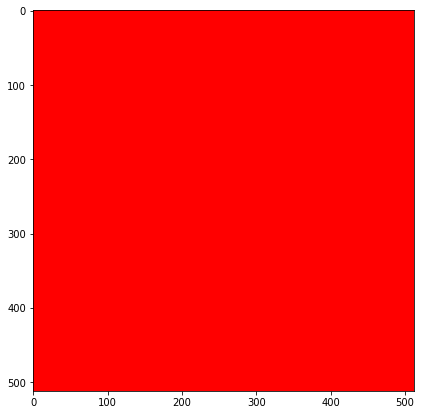

Iter # 20 , PSRN NOISY:  2.917047059050264 ; PSRN GT:  4.040187055092311


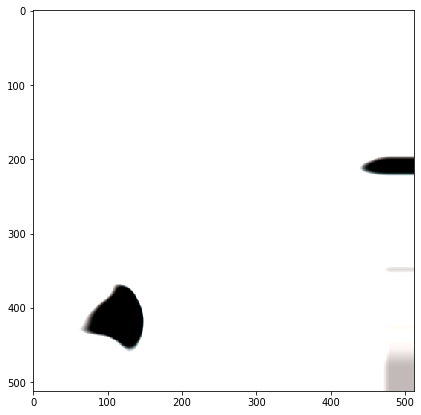

Iter # 40 , PSRN NOISY:  3.2266575183212853 ; PSRN GT:  4.364833752800602


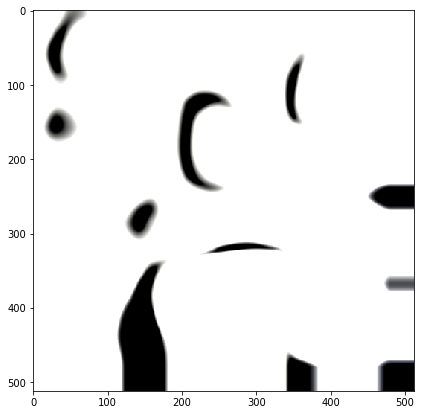

Iter # 60 , PSRN NOISY:  4.357415025795667 ; PSRN GT:  5.311778718819067


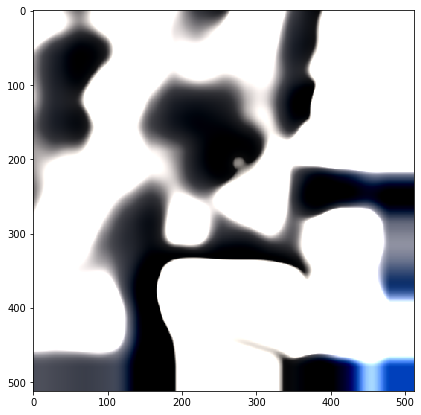

Iter # 80 , PSRN NOISY:  6.104001455076922 ; PSRN GT:  7.441981555125125


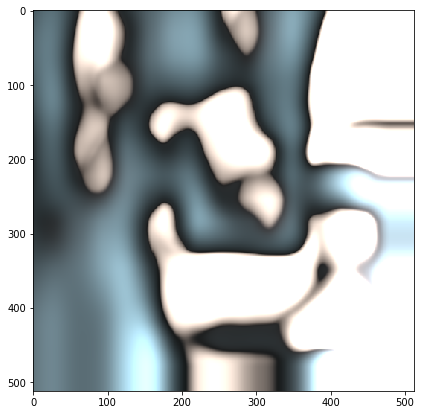

Iter # 100 , PSRN NOISY:  7.035361400308908 ; PSRN GT:  7.948105298435535


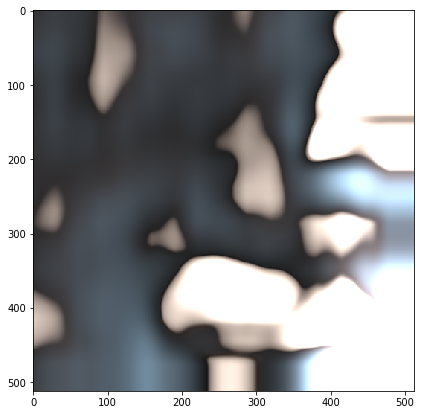

Iter # 120 , PSRN NOISY:  7.49222371209321 ; PSRN GT:  9.794276550276782


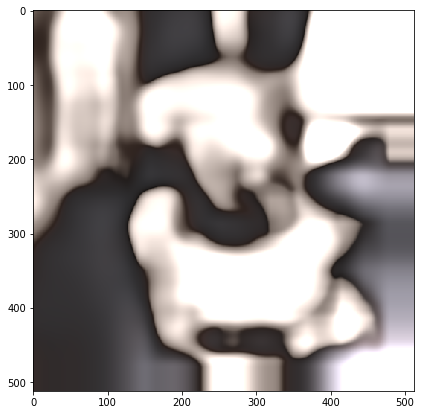

Iter # 140 , PSRN NOISY:  8.51968241094413 ; PSRN GT:  11.789305217844884


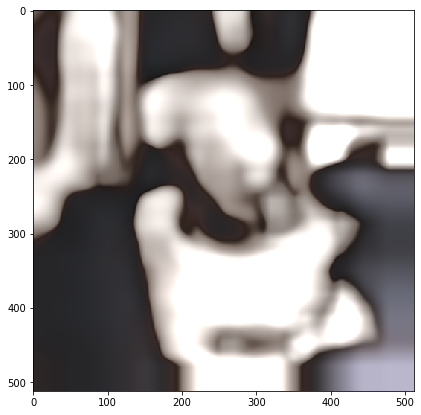

Iter # 160 , PSRN NOISY:  10.994093685360973 ; PSRN GT:  14.940569294498967


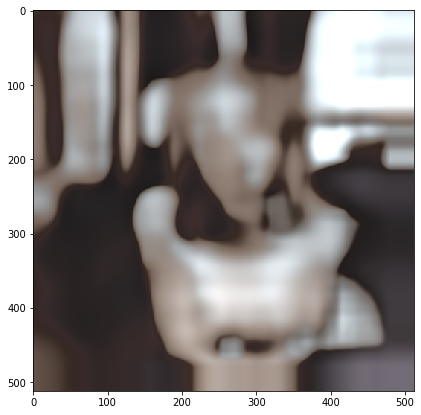

Iter # 180 , PSRN NOISY:  11.935384140704329 ; PSRN GT:  14.173547865751654


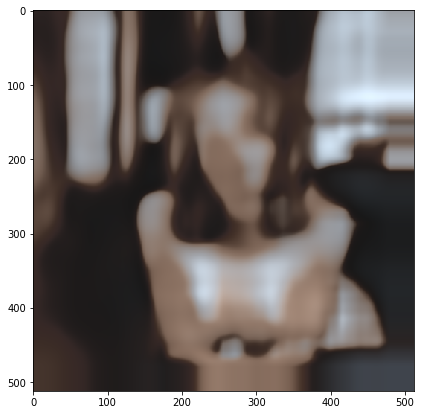

Iter # 200 , PSRN NOISY:  11.760604044755967 ; PSRN GT:  14.311474197570597


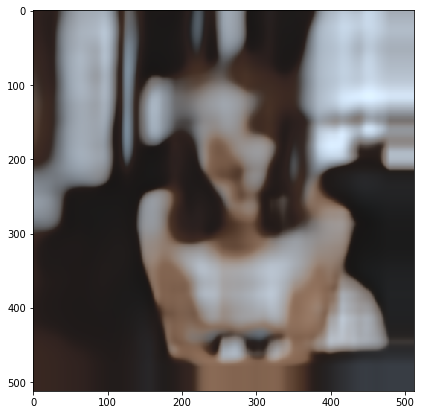

Iter # 220 , PSRN NOISY:  12.00056081695168 ; PSRN GT:  13.912816988780481


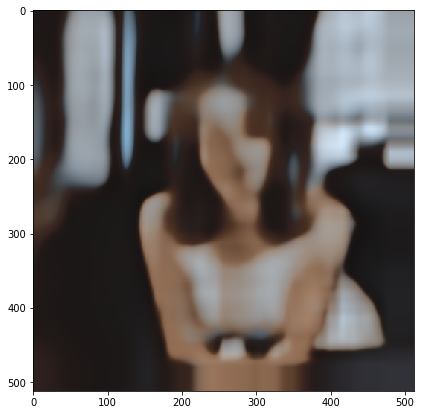

Iter # 240 , PSRN NOISY:  12.201832117867122 ; PSRN GT:  14.300459244853004


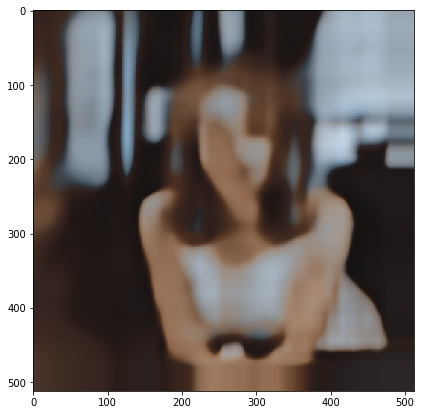

Iter # 260 , PSRN NOISY:  12.039760328758513 ; PSRN GT:  13.498081458477644


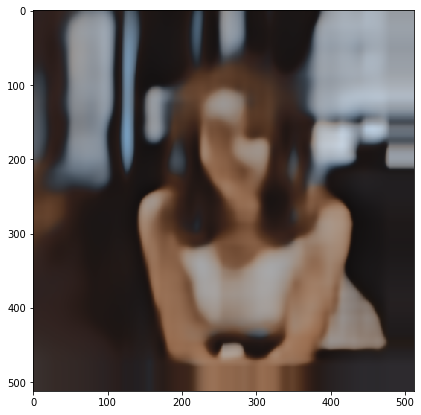

Iter # 280 , PSRN NOISY:  12.281688208669497 ; PSRN GT:  14.322840269281631


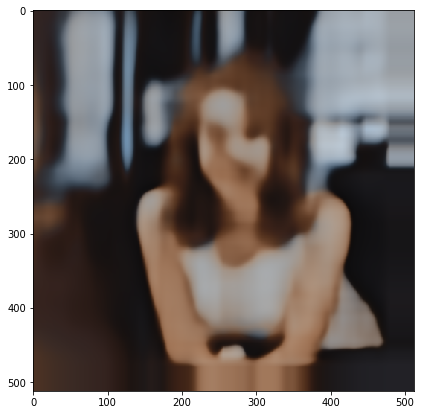

Iter # 300 , PSRN NOISY:  12.083131741285653 ; PSRN GT:  13.539597128982486


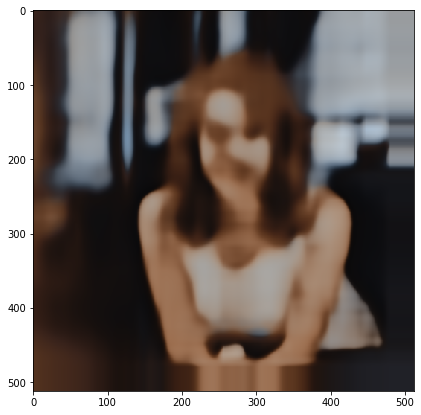

Iter # 320 , PSRN NOISY:  12.260228785443314 ; PSRN GT:  14.023365165195578


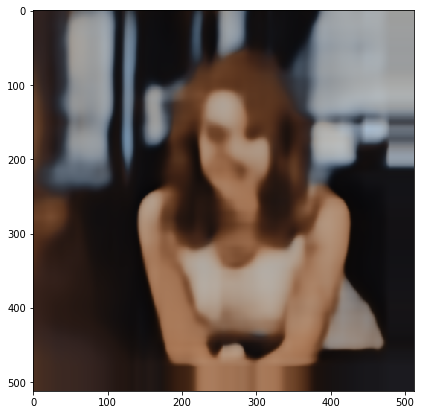

Iter # 340 , PSRN NOISY:  12.303850598157451 ; PSRN GT:  14.260728074516413


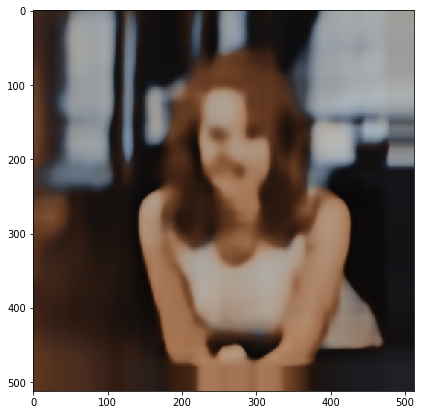

Iter # 360 , PSRN NOISY:  12.190292169659394 ; PSRN GT:  13.737083712422537


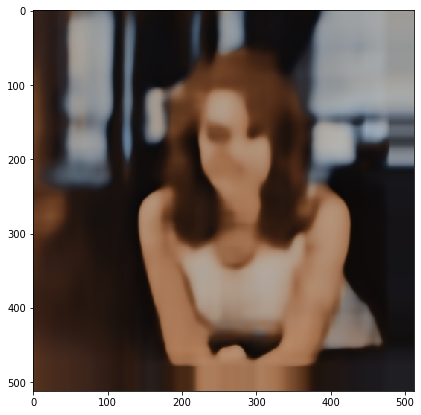

In [ ]:
for i in range(1800):
    model.train_on_batch(input_noise + np.random.normal(0, 1/30.0, (height, width, 32)), img_masked[None, :, :, :])
    
    if i % 20 == 0:
        out = np.clip(model.predict(input_noise)[0], 0, 255).astype(np.uint8)
        cv2.imwrite("v3_res_out_"+str(i)+".png", out)
        
        psrn_noisy = compare_psnr(img_masked, out) 
        psrn_gt = compare_psnr(image, out)
        print("Iter #", i, ", PSRN NOISY: ", psrn_noisy, "; PSRN GT: ", psrn_gt)
        
        plt.figure(figsize=(7, 7))
        plt.imshow(out[:,:,::-1])
        plt.show()


# Save Model

In [35]:
model.save("model_res.h5")

# Load Model

In [45]:
import keras.losses
keras.losses.mse_mask = mse_mask

In [46]:
from keras.models import load_model
model_loaded = load_model('model_res.h5')

Iter # 0 , PSRN NOISY:  12.292097636455392 ; PSRN GT:  19.619249662114985


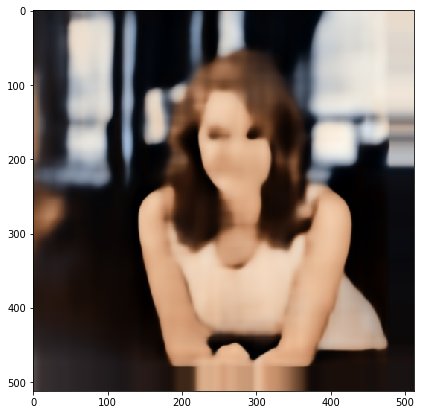

Iter # 20 , PSRN NOISY:  10.842357282243867 ; PSRN GT:  19.258759765635787


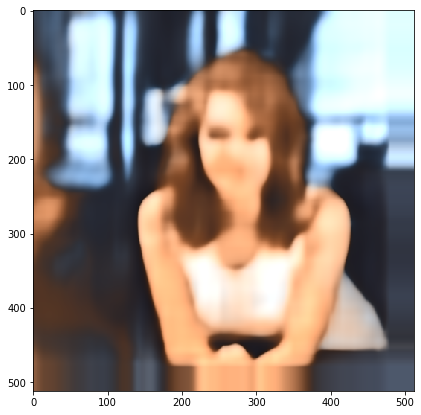

Iter # 40 , PSRN NOISY:  11.620776705023172 ; PSRN GT:  22.12788525587856


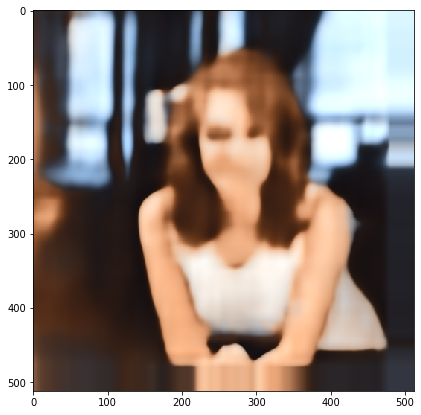

Iter # 60 , PSRN NOISY:  12.134533111006975 ; PSRN GT:  22.92634161749044


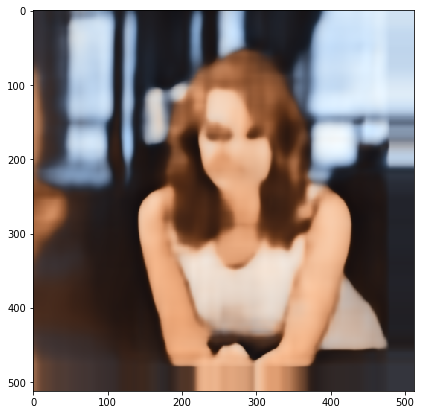

Iter # 80 , PSRN NOISY:  12.31230109047882 ; PSRN GT:  22.917398607238614


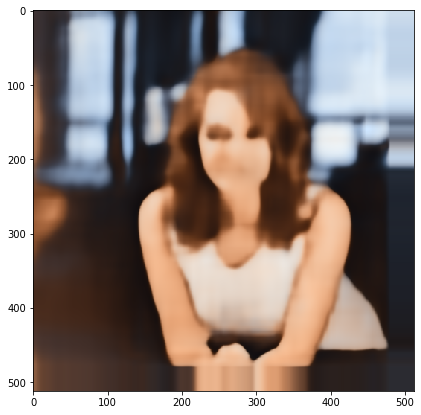

Iter # 100 , PSRN NOISY:  12.401419913277117 ; PSRN GT:  22.81500490944238


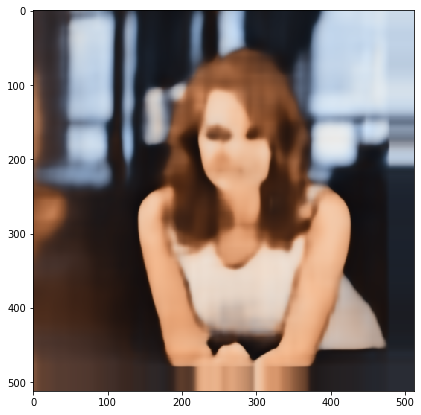

Iter # 120 , PSRN NOISY:  12.446495053736005 ; PSRN GT:  22.542842090584223


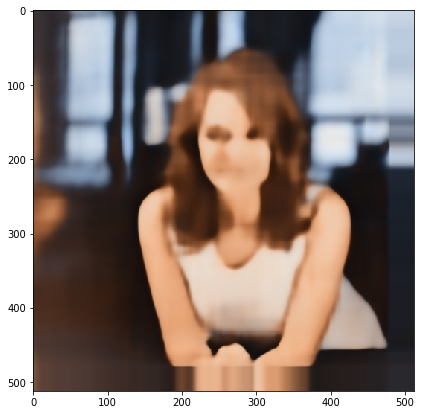

Iter # 140 , PSRN NOISY:  12.50200002747808 ; PSRN GT:  22.166818450455196


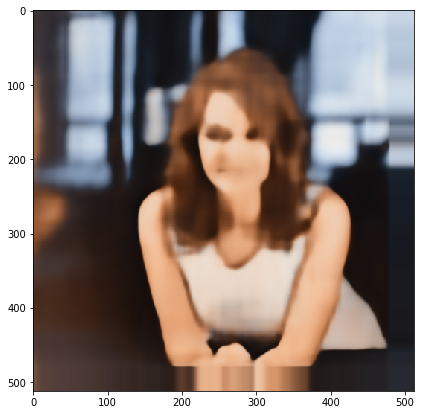

Iter # 160 , PSRN NOISY:  12.449495053977644 ; PSRN GT:  22.371866401559704


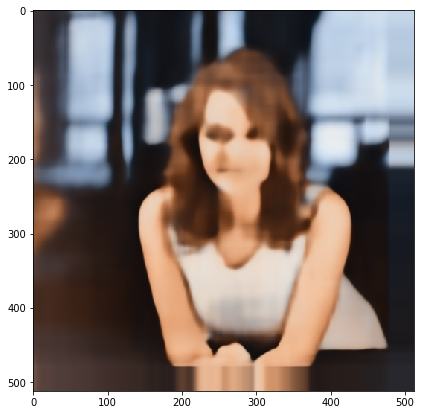

Iter # 180 , PSRN NOISY:  12.430359937267767 ; PSRN GT:  23.088736070064996


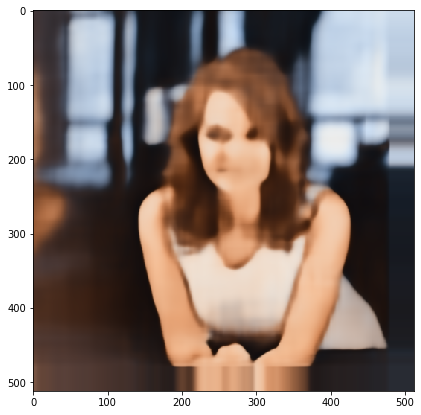

Iter # 200 , PSRN NOISY:  12.417455370725058 ; PSRN GT:  22.774699629723322


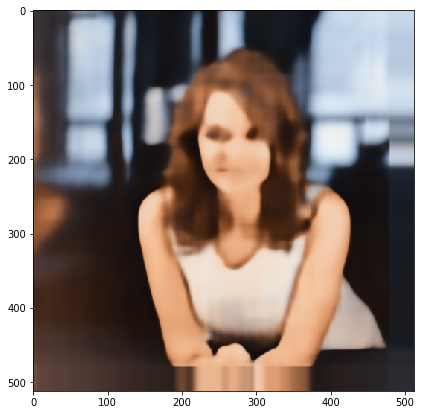

Iter # 220 , PSRN NOISY:  12.390637957723085 ; PSRN GT:  23.175453672916788


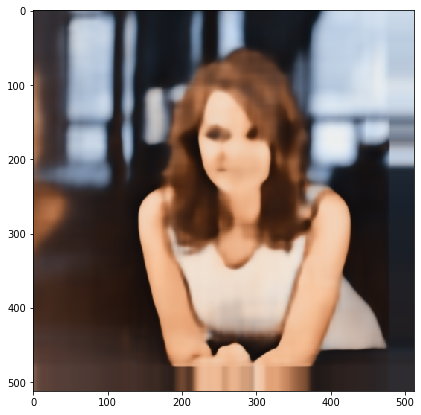

Iter # 240 , PSRN NOISY:  12.33603219359721 ; PSRN GT:  23.804826256058497


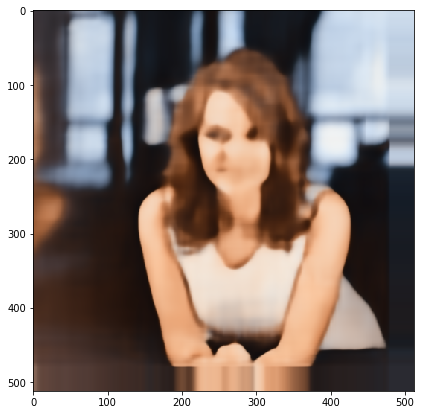

Iter # 260 , PSRN NOISY:  12.412194736972326 ; PSRN GT:  23.337400588036772


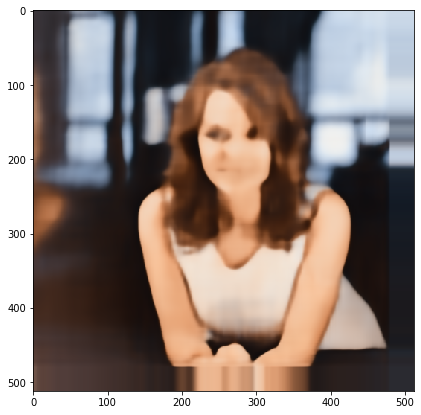

Iter # 280 , PSRN NOISY:  12.450964844557284 ; PSRN GT:  23.109689277952917


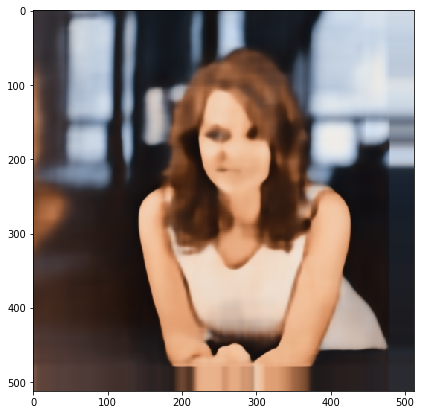

Iter # 300 , PSRN NOISY:  12.368442318928745 ; PSRN GT:  23.699342856373896


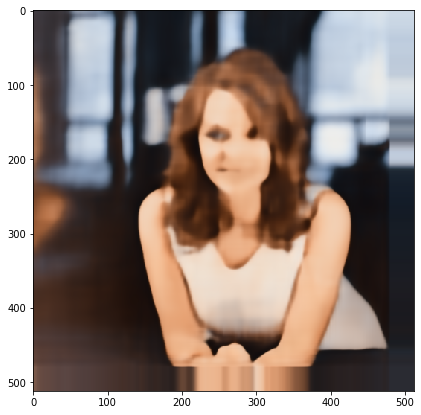

Iter # 320 , PSRN NOISY:  12.305677635212383 ; PSRN GT:  24.144859820626845


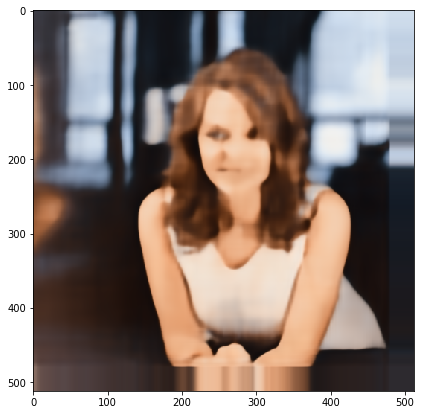

Iter # 340 , PSRN NOISY:  12.408646659883535 ; PSRN GT:  23.574816527334615


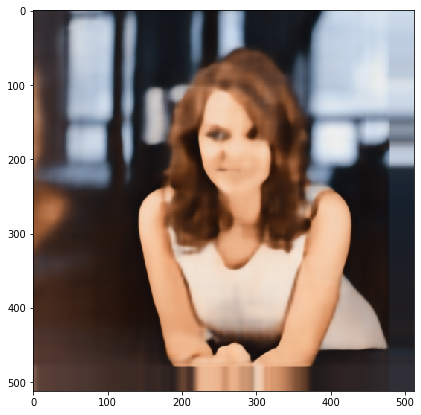

Iter # 360 , PSRN NOISY:  12.398336983417376 ; PSRN GT:  23.831999486366186


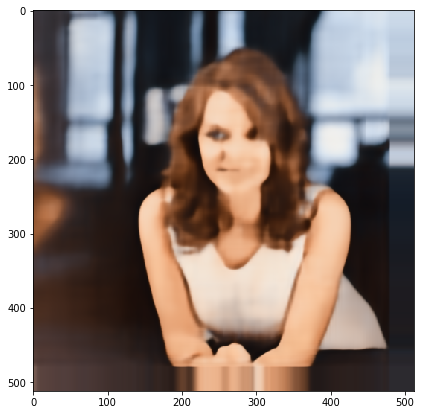

Iter # 380 , PSRN NOISY:  12.269441808882027 ; PSRN GT:  24.61679050385763


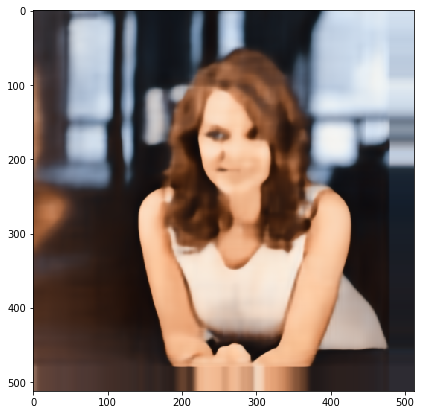

Iter # 400 , PSRN NOISY:  12.443212022490723 ; PSRN GT:  23.41399778844874


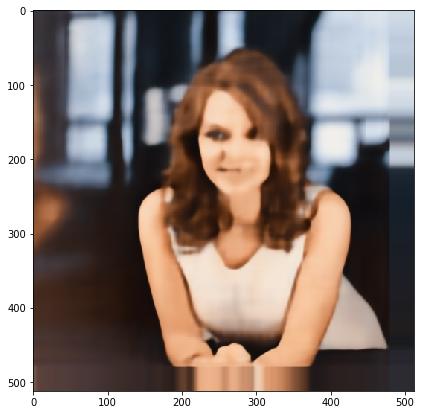

Iter # 420 , PSRN NOISY:  12.415650760074833 ; PSRN GT:  23.6288242337136


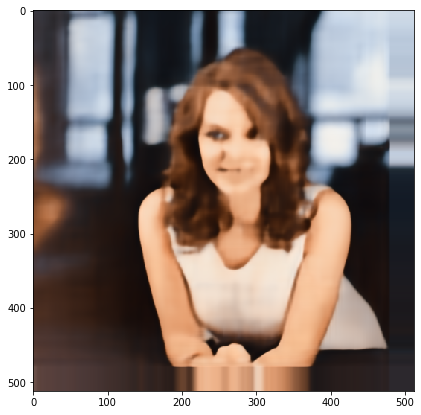

Iter # 440 , PSRN NOISY:  12.258513381986027 ; PSRN GT:  24.633718946019684


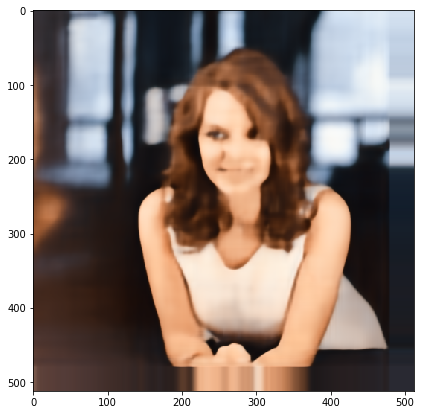

Iter # 460 , PSRN NOISY:  12.330751504467283 ; PSRN GT:  24.53491855210626


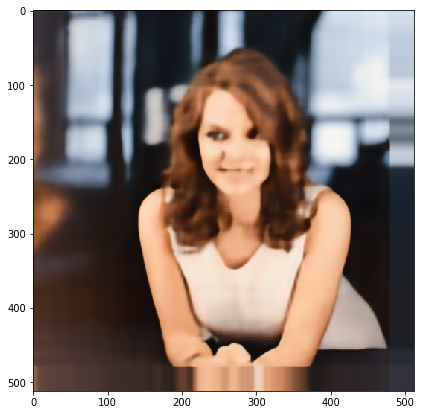

Iter # 480 , PSRN NOISY:  12.28640633056438 ; PSRN GT:  24.75196518645423


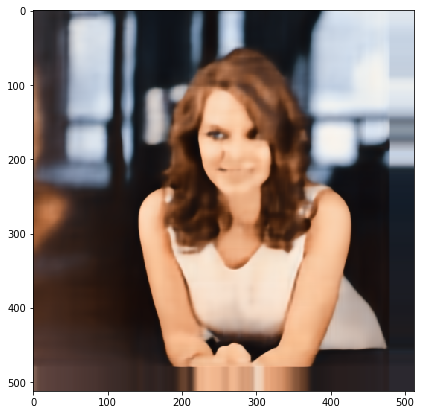

Iter # 500 , PSRN NOISY:  12.359284436845758 ; PSRN GT:  24.550543878653542


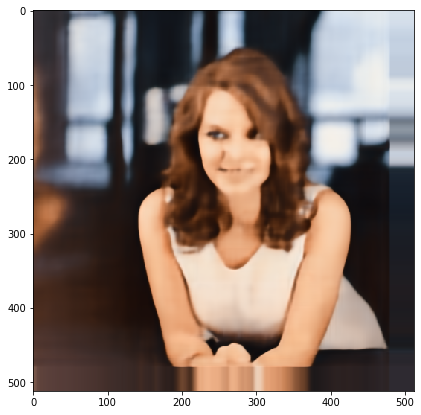

Iter # 520 , PSRN NOISY:  12.242845684056629 ; PSRN GT:  25.0863487756305


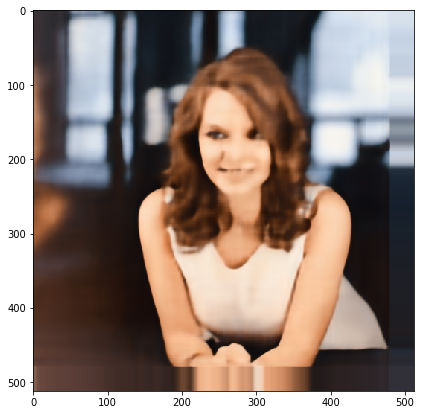

Iter # 540 , PSRN NOISY:  12.288018045525877 ; PSRN GT:  24.738821895231293


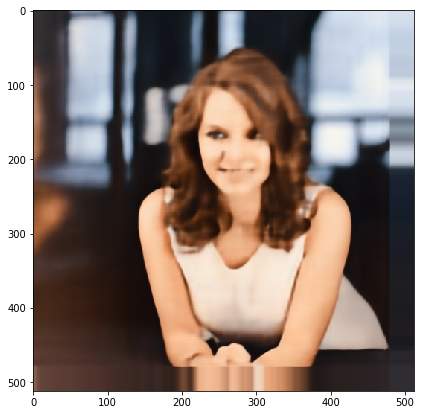

Iter # 560 , PSRN NOISY:  12.262180728014169 ; PSRN GT:  24.902753385432913


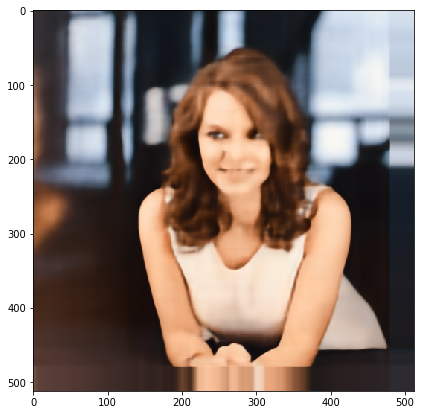

Iter # 580 , PSRN NOISY:  12.210073697592197 ; PSRN GT:  25.048718892130143


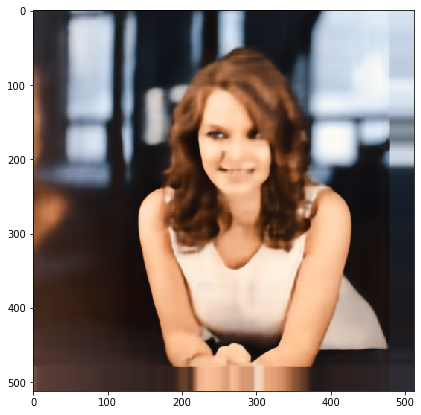

Iter # 600 , PSRN NOISY:  12.206813268629592 ; PSRN GT:  25.42563580111445


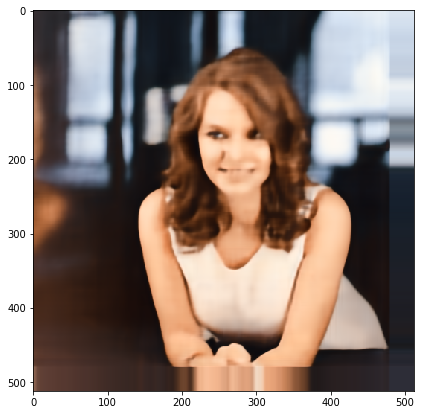

Iter # 620 , PSRN NOISY:  12.25578491285745 ; PSRN GT:  25.482143010974184


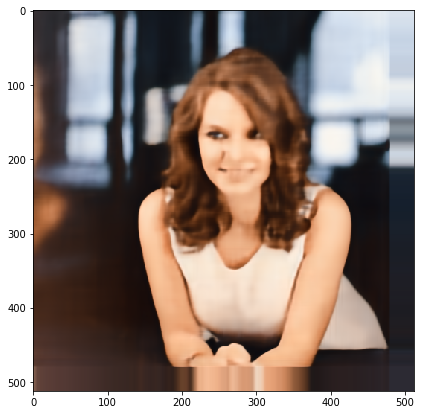

Iter # 640 , PSRN NOISY:  12.190535820235933 ; PSRN GT:  25.646054099257974


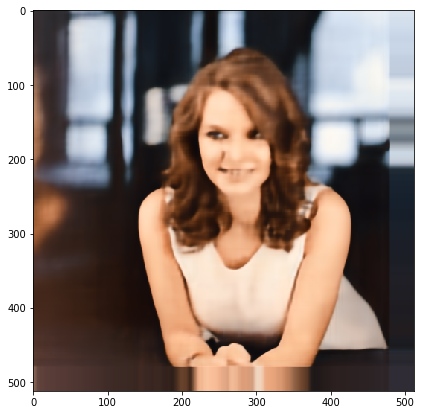

Iter # 660 , PSRN NOISY:  12.305397874514728 ; PSRN GT:  25.077184826996124


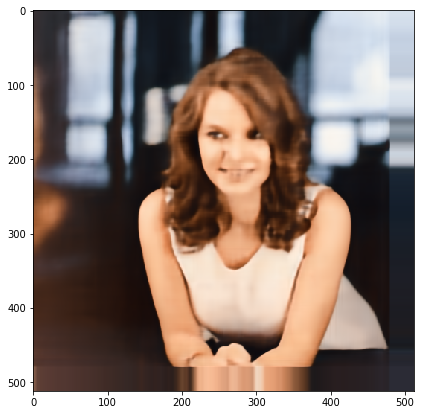

Iter # 680 , PSRN NOISY:  12.26318385808601 ; PSRN GT:  25.352696759795


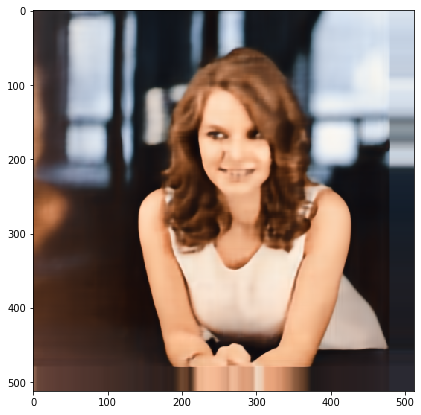

Iter # 700 , PSRN NOISY:  12.254091904834185 ; PSRN GT:  25.215464452826687


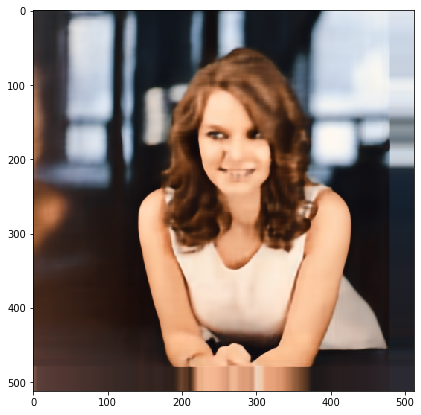

Iter # 720 , PSRN NOISY:  12.209280537199813 ; PSRN GT:  25.31446044121774


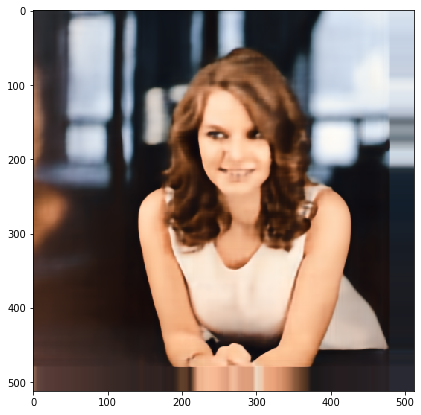

Iter # 740 , PSRN NOISY:  12.21555857803397 ; PSRN GT:  25.738686783134277


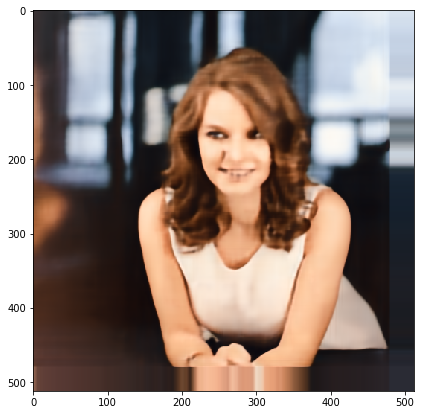

Iter # 760 , PSRN NOISY:  12.30356833238748 ; PSRN GT:  25.47908963949478


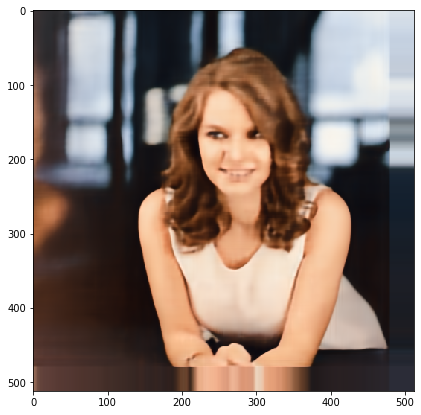

Iter # 780 , PSRN NOISY:  12.183226883540538 ; PSRN GT:  26.137478928922487


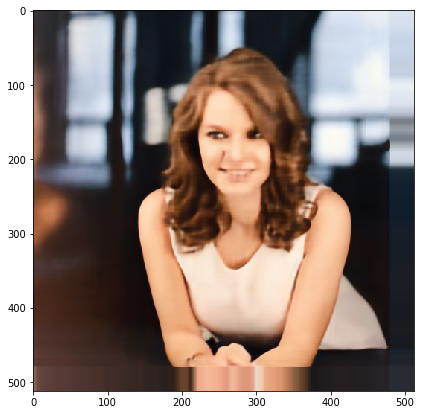

Iter # 800 , PSRN NOISY:  12.147846259010823 ; PSRN GT:  26.048938627345866


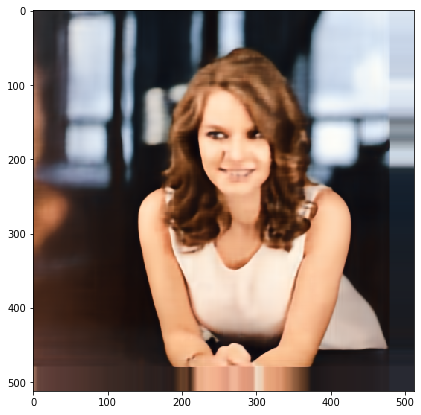

Iter # 820 , PSRN NOISY:  12.186732997680416 ; PSRN GT:  25.94430273200384


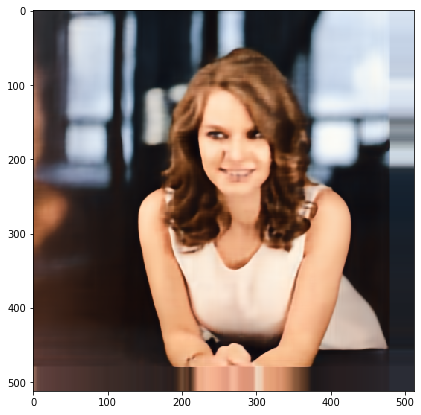

Iter # 840 , PSRN NOISY:  11.936864729926803 ; PSRN GT:  26.277222170799455


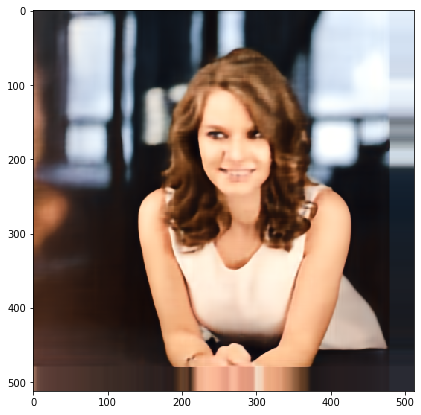

Iter # 860 , PSRN NOISY:  12.131076491012456 ; PSRN GT:  26.433465511423144


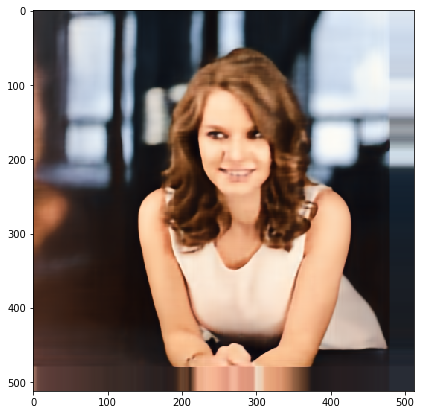

Iter # 880 , PSRN NOISY:  12.139675665779448 ; PSRN GT:  26.076638098165944


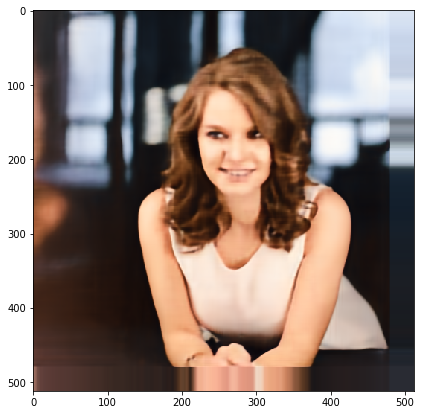

Iter # 900 , PSRN NOISY:  12.149967867847293 ; PSRN GT:  26.3621350841346


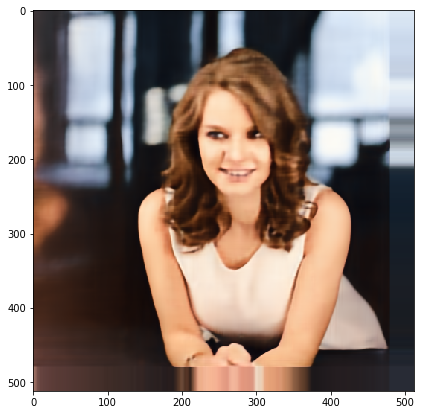

Iter # 920 , PSRN NOISY:  12.161674631003592 ; PSRN GT:  26.413165949060197


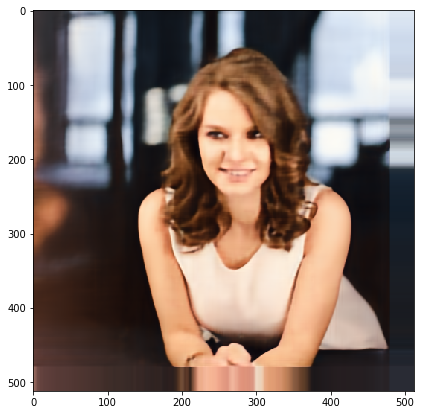

Iter # 940 , PSRN NOISY:  12.067808984136716 ; PSRN GT:  26.78225897943141


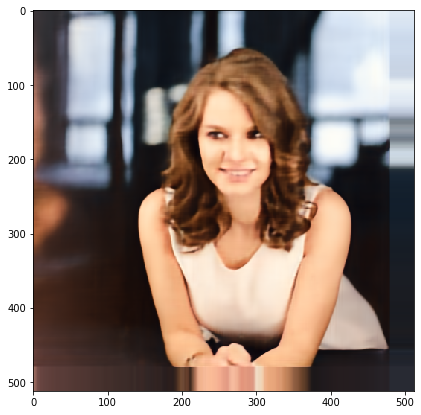

Iter # 960 , PSRN NOISY:  12.089326337147483 ; PSRN GT:  26.46080176798266


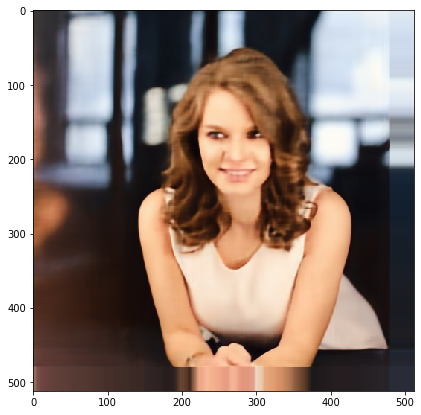

Iter # 980 , PSRN NOISY:  12.057327953641696 ; PSRN GT:  26.816115996704212


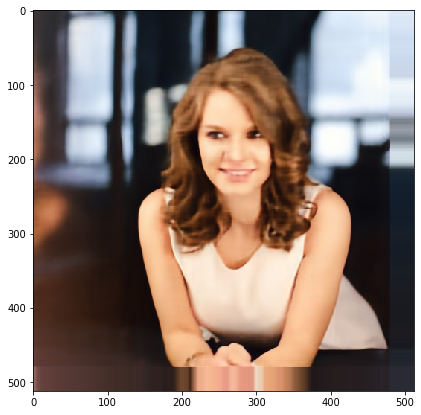

Iter # 1000 , PSRN NOISY:  12.121593630525627 ; PSRN GT:  26.80565680894287


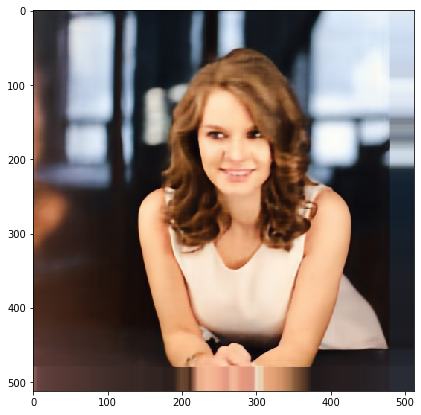

Iter # 1020 , PSRN NOISY:  12.151813286571178 ; PSRN GT:  26.69860642751174


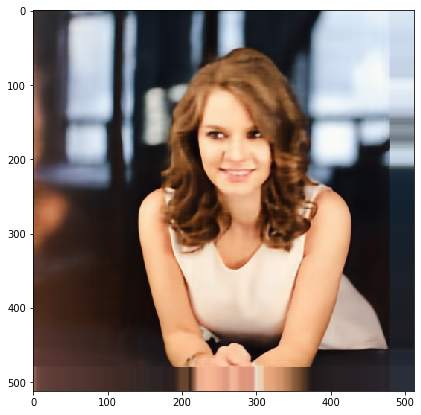

Iter # 1040 , PSRN NOISY:  12.152480425896817 ; PSRN GT:  26.63699211476134


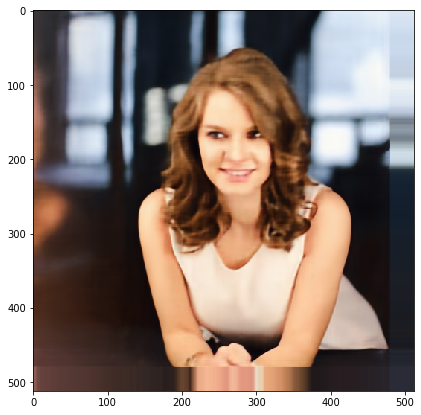

Iter # 1060 , PSRN NOISY:  12.102271814674623 ; PSRN GT:  26.6240068636505


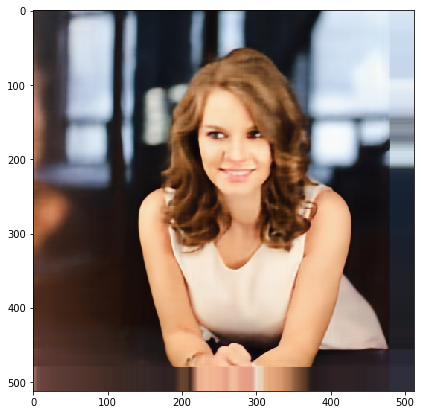

Iter # 1080 , PSRN NOISY:  12.047322146184168 ; PSRN GT:  27.109859151672545


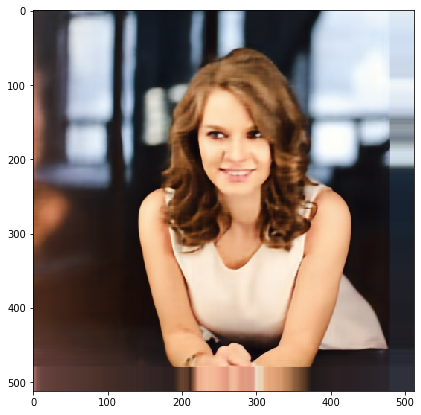

Iter # 1100 , PSRN NOISY:  12.070798319301115 ; PSRN GT:  26.91060793000908


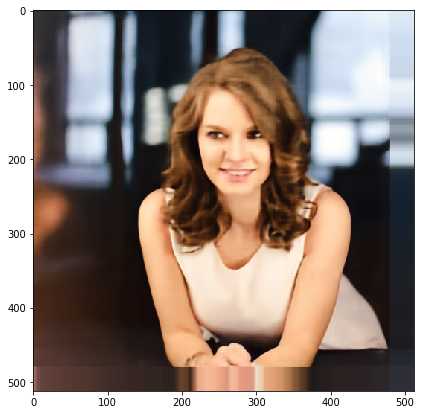

Iter # 1120 , PSRN NOISY:  11.99957243784745 ; PSRN GT:  27.18714389775088


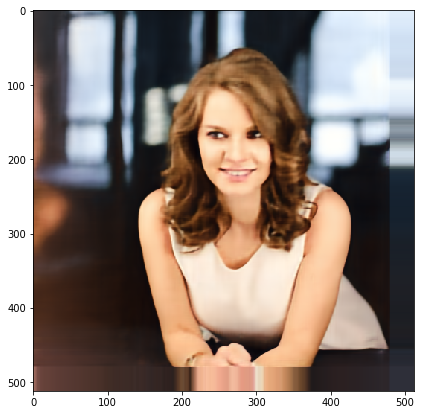

Iter # 1140 , PSRN NOISY:  12.041504939146927 ; PSRN GT:  27.04564562725192


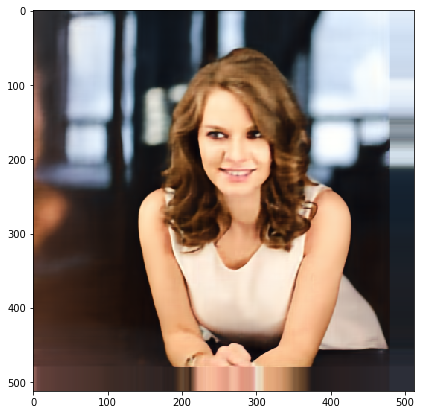

Iter # 1160 , PSRN NOISY:  12.038995044426947 ; PSRN GT:  27.158957049350573


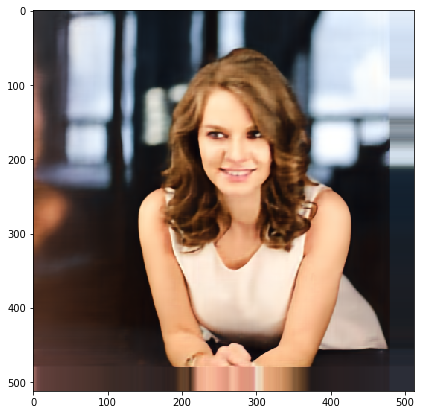

Iter # 1180 , PSRN NOISY:  12.072646719929594 ; PSRN GT:  27.22645957248657


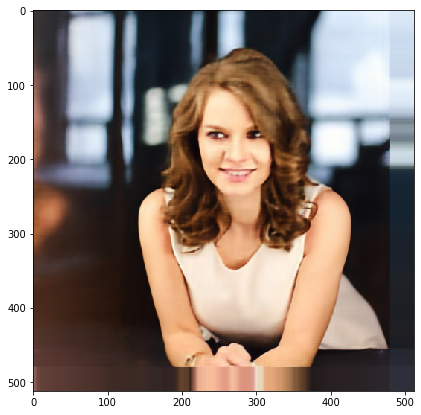

Iter # 1200 , PSRN NOISY:  11.997684015488144 ; PSRN GT:  27.36588215257793


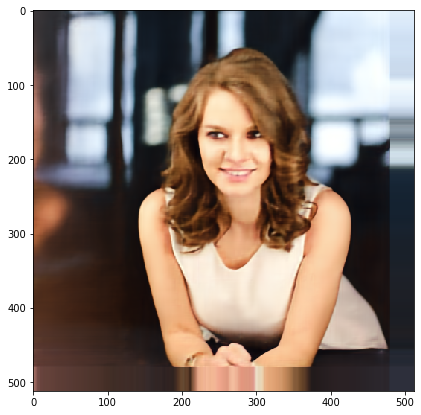

Iter # 1220 , PSRN NOISY:  12.061545687005712 ; PSRN GT:  27.2223347766367


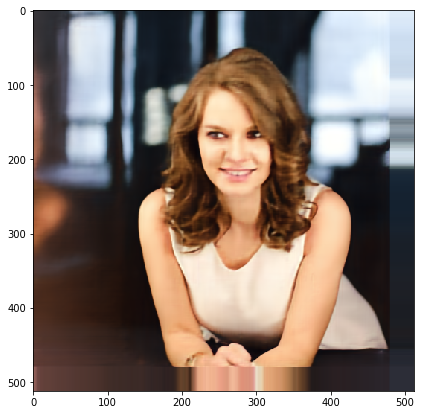

Iter # 1240 , PSRN NOISY:  12.048201501517955 ; PSRN GT:  27.332439969858928


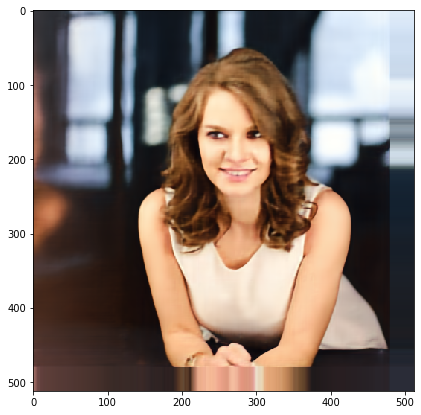

Iter # 1260 , PSRN NOISY:  12.151953224206707 ; PSRN GT:  26.921392990755947


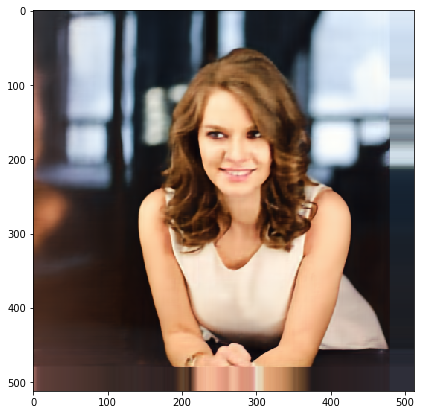

Iter # 1280 , PSRN NOISY:  12.042546881368159 ; PSRN GT:  27.421701644478492


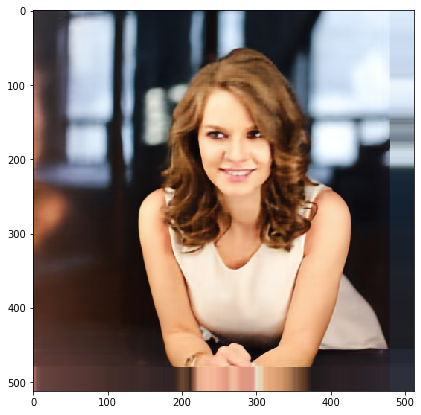

Iter # 1300 , PSRN NOISY:  12.050574716153207 ; PSRN GT:  27.347894226187563


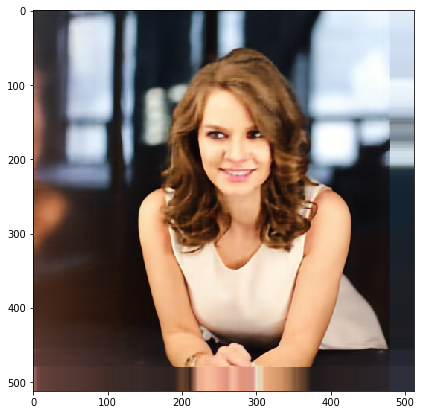

Iter # 1320 , PSRN NOISY:  12.036343922676082 ; PSRN GT:  27.240584101880124


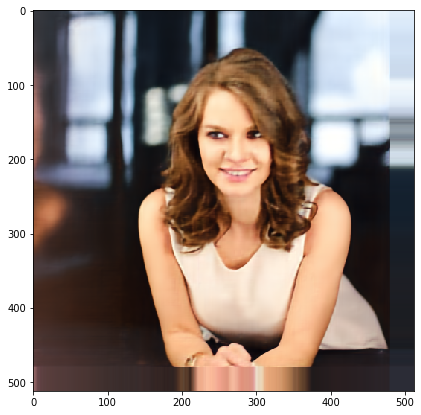

Iter # 1340 , PSRN NOISY:  12.041348961257265 ; PSRN GT:  27.484627149158673


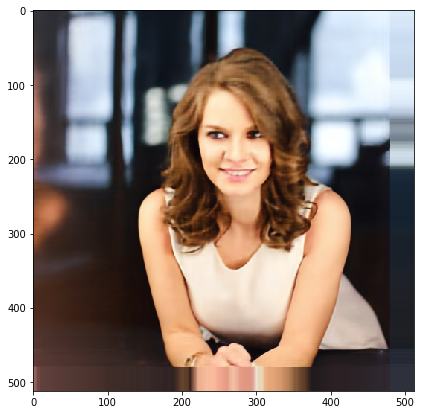

Iter # 1360 , PSRN NOISY:  12.055369763869926 ; PSRN GT:  27.4640674788821


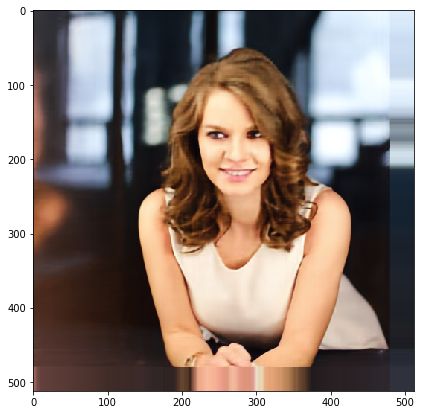

Iter # 1380 , PSRN NOISY:  12.160154116488664 ; PSRN GT:  26.306043879399205


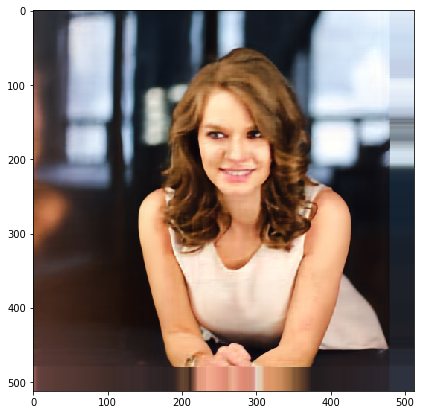

Iter # 1400 , PSRN NOISY:  12.352300094364894 ; PSRN GT:  25.71981885638243


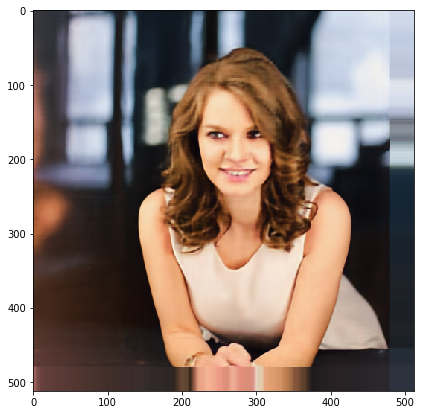

Iter # 1420 , PSRN NOISY:  12.226481260239268 ; PSRN GT:  26.735740162466307


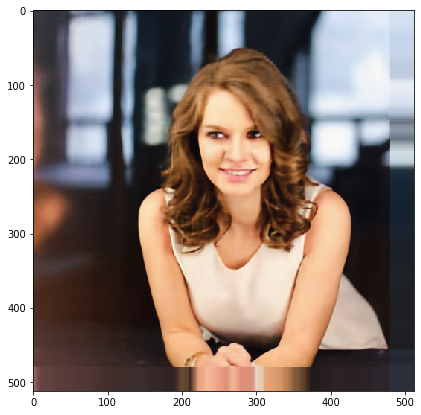

Iter # 1440 , PSRN NOISY:  12.183160973510434 ; PSRN GT:  27.042338999726276


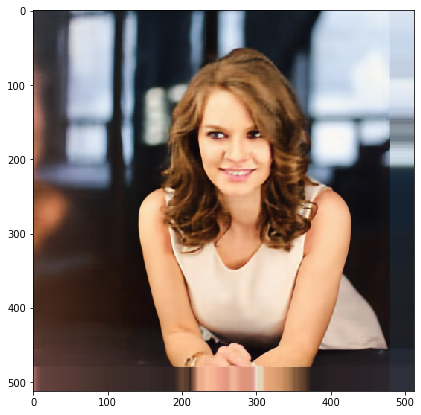

Iter # 1460 , PSRN NOISY:  12.139393637103401 ; PSRN GT:  27.24799200863224


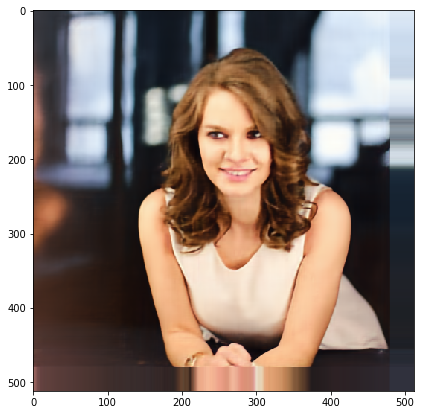

Iter # 1480 , PSRN NOISY:  12.039544999491333 ; PSRN GT:  27.465161112130552


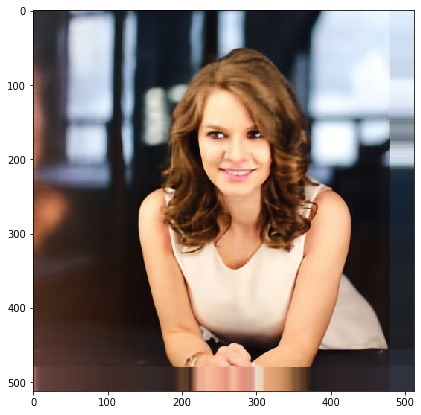

Iter # 1500 , PSRN NOISY:  12.061736029191817 ; PSRN GT:  27.457496653840433


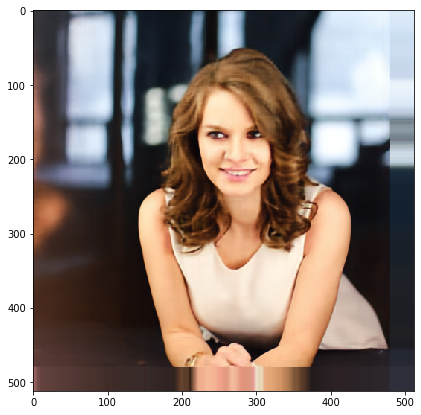

Iter # 1520 , PSRN NOISY:  11.988383513662255 ; PSRN GT:  27.52419987605171


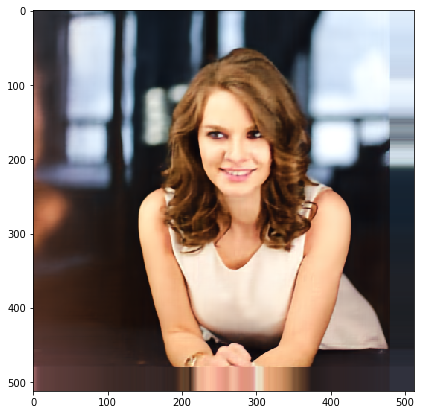

Iter # 1540 , PSRN NOISY:  12.032162670534785 ; PSRN GT:  27.496133618076723


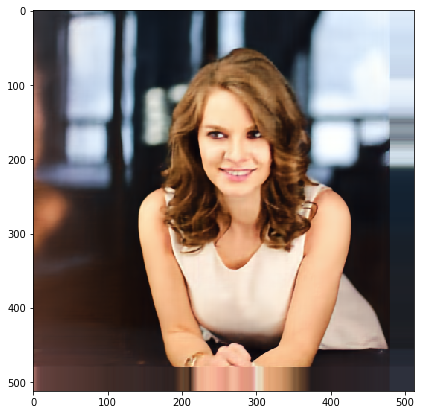

Iter # 1560 , PSRN NOISY:  12.1164999350116 ; PSRN GT:  27.177586240279425


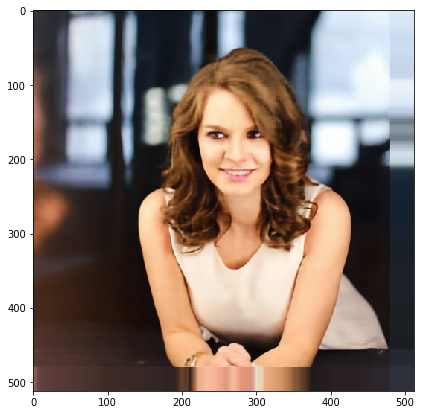

Iter # 1580 , PSRN NOISY:  11.984884486603868 ; PSRN GT:  27.431712285066503


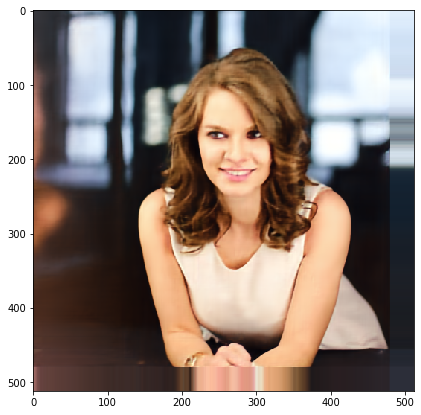

Iter # 1600 , PSRN NOISY:  12.030922918887574 ; PSRN GT:  27.388296711136967


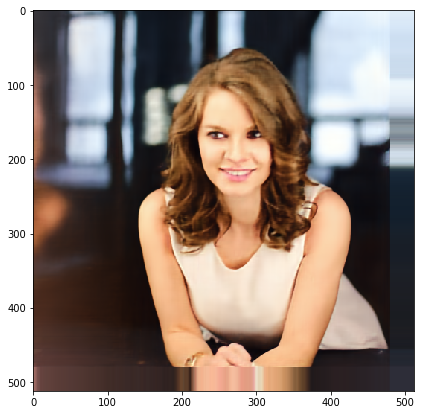

Iter # 1620 , PSRN NOISY:  11.992262135996654 ; PSRN GT:  27.51871275196963


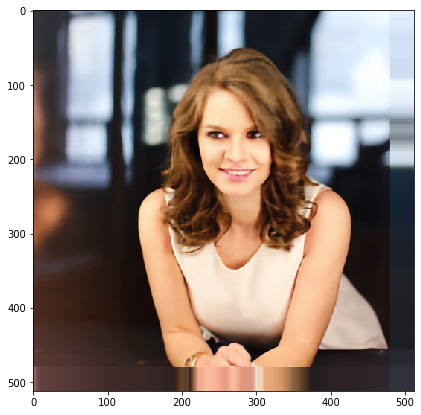

Iter # 1640 , PSRN NOISY:  12.02462251484986 ; PSRN GT:  27.62301255092385


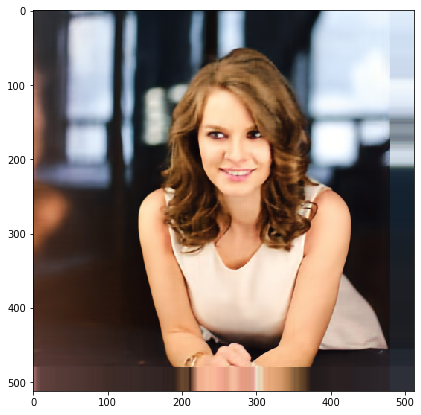

Iter # 1660 , PSRN NOISY:  12.04568008219204 ; PSRN GT:  27.25474569122187


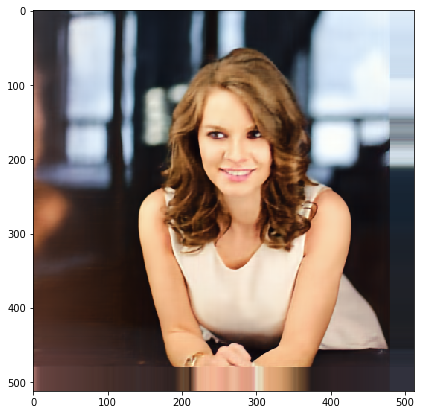

Iter # 1680 , PSRN NOISY:  11.985010801543938 ; PSRN GT:  27.61219730449905


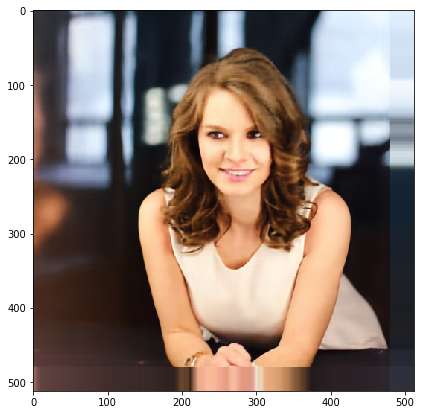

Iter # 1700 , PSRN NOISY:  12.012853023942608 ; PSRN GT:  27.51238177564079


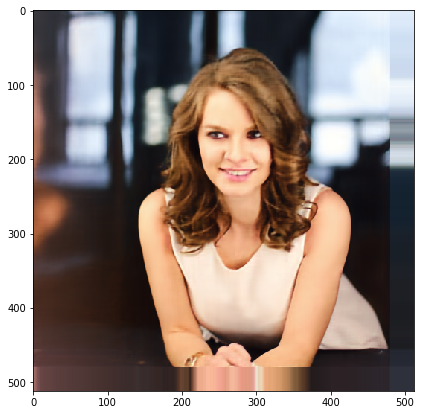

Iter # 1720 , PSRN NOISY:  11.94611721156593 ; PSRN GT:  27.52402852805171


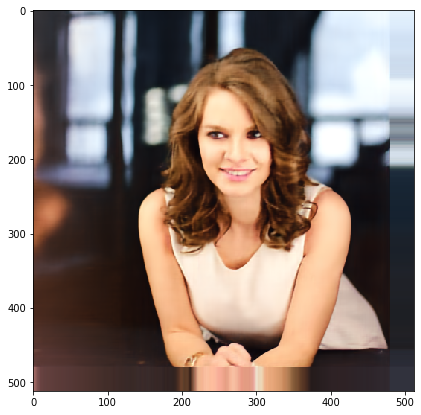

Iter # 1740 , PSRN NOISY:  11.994392797062247 ; PSRN GT:  27.554082191772757


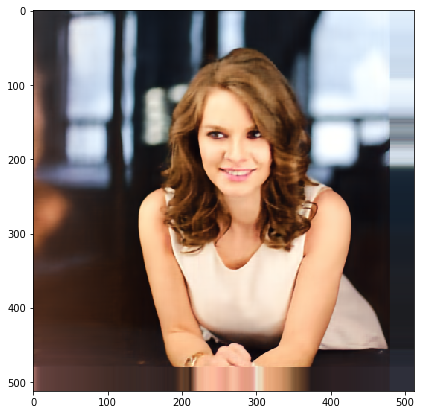

Iter # 1760 , PSRN NOISY:  12.01731358990947 ; PSRN GT:  27.571106144753514


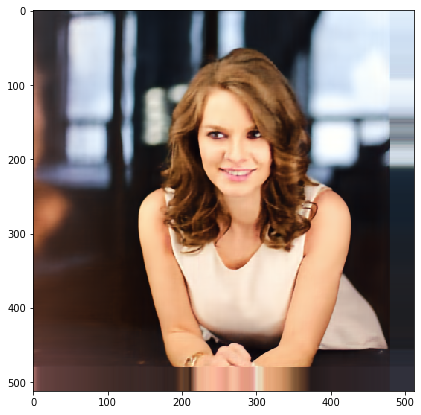

Iter # 1780 , PSRN NOISY:  12.037895254923258 ; PSRN GT:  27.60613964707844


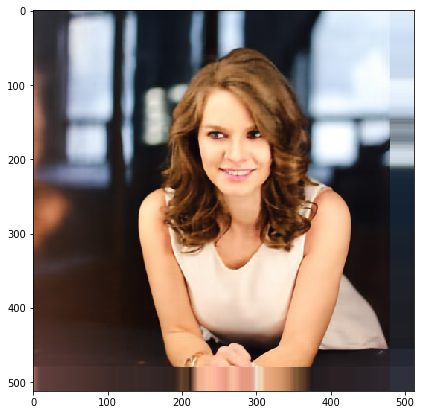

In [48]:
for i in range(1800):
    model_loaded.train_on_batch(input_noise + np.random.normal(0, 1/30.0, (height, width, 32)), img_masked[None, :, :, :])
    
    if i % 20 == 0:
        out = np.clip(model_loaded.predict(input_noise)[0], 0, 255).astype(np.uint8)
        cv2.imwrite("v3_res_out_"+str(i+440)+".png", out)
        
        psrn_noisy = compare_psnr(img_masked, out) 
        psrn_gt = compare_psnr(image, out)
        print("Iter #", i, ", PSRN NOISY: ", psrn_noisy, "; PSRN GT: ", psrn_gt)
        
        plt.figure(figsize=(7, 7))
        plt.imshow(out[:,:,::-1])
        plt.show()